Data Preprocessing

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns 

In [2]:
# Load the dataset and set the first column as the index
df = pd.read_csv('dataset_tk.csv', index_col=0)

# Convert data types
df.index = pd.to_datetime(df.index, dayfirst=True)

# Normalize column names
df.columns = df.columns.str.strip().str.replace(' ', '_').str.replace('&', 'and')

# Rename the index column
df.index.name = 'Date'

# Remove unnecessary columns (if any)
# For example, if there is an unnamed column at the start, we can drop it
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

# Handle missing values by taking the mean of the values
for column in df.columns:
    if df[column].isnull().any():
        df[column].fillna(df[column].mean(), inplace=True)

# Save the cleaned dataset
df.to_csv('cleaned_dataset_tk.csv')

EDA

In [3]:
df = pd.read_csv('cleaned_dataset_tk.csv', index_col=0, parse_dates=True)

In [4]:
print("Shape: ", df.shape)
print("Data Types: ", df.dtypes)

Shape:  (503, 33)
Data Types:  Punjab               float64
Haryana              float64
Rajasthan            float64
Delhi                float64
UP                   float64
Uttarakhand          float64
HP                   float64
JandK                float64
Chandigarh           float64
Chhattisgarh         float64
Gujarat              float64
MP                   float64
Maharashtra          float64
Goa                  float64
DNH                  float64
Andhra_Pradesh       float64
Telangana            float64
Karnataka            float64
Kerala               float64
Tamil_Nadu           float64
Pondy                float64
Bihar                float64
Jharkhand            float64
Odisha               float64
West_Bengal          float64
Sikkim               float64
Arunachal_Pradesh    float64
Assam                float64
Manipur              float64
Meghalaya            float64
Mizoram              float64
Nagaland             float64
Tripura              float64
dtype: objec

In [5]:
print(df.describe()) 
df.describe().to_csv('describe.csv')

           Punjab     Haryana   Rajasthan       Delhi          UP  \
count  503.000000  503.000000  503.000000  503.000000  503.000000   
mean   141.145527  138.333598  218.443340   83.380716  314.036382   
std     56.977361   38.106593   27.421615   25.915357   66.516960   
min     56.100000   64.800000  105.800000   41.800000  186.800000   
25%    104.000000  114.800000  205.800000   63.500000  263.650000   
50%    118.300000  126.800000  222.900000   72.700000  290.000000   
75%    162.500000  158.100000  237.600000  105.800000  370.550000   
max    300.000000  237.200000  278.000000  147.100000  471.800000   

       Uttarakhand          HP       JandK  Chandigarh  Chhattisgarh  ...  \
count   503.000000  503.000000  503.000000  503.000000    503.000000  ...   
mean     36.157058   26.568191   44.264016    4.141551     83.877137  ...   
std       6.705108    4.807040    4.769391    1.143422     10.130427  ...   
min      16.800000   11.800000   17.800000    2.200000     37.200000  

In [6]:
print("Missing Values: ", df.isnull().sum())

Missing Values:  Punjab               0
Haryana              0
Rajasthan            0
Delhi                0
UP                   0
Uttarakhand          0
HP                   0
JandK                0
Chandigarh           0
Chhattisgarh         0
Gujarat              0
MP                   0
Maharashtra          0
Goa                  0
DNH                  0
Andhra_Pradesh       0
Telangana            0
Karnataka            0
Kerala               0
Tamil_Nadu           0
Pondy                0
Bihar                0
Jharkhand            0
Odisha               0
West_Bengal          0
Sikkim               0
Arunachal_Pradesh    0
Assam                0
Manipur              0
Meghalaya            0
Mizoram              0
Nagaland             0
Tripura              0
dtype: int64


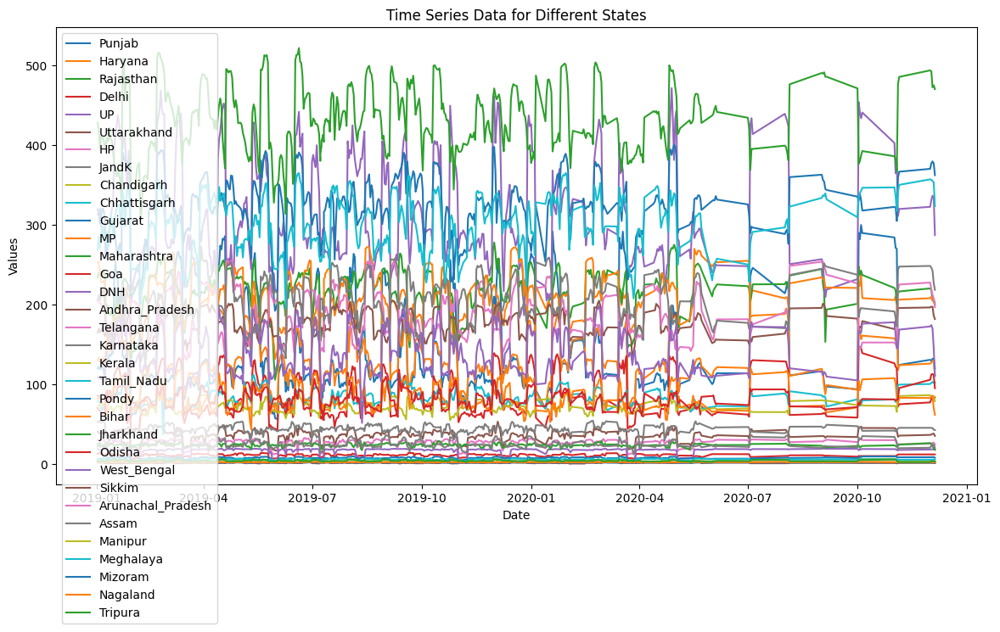

In [7]:
plt.figure(figsize=(14, 7))
plt.plot(df)
plt.title('Time Series Data for Different States')
plt.xlabel('Date')
plt.ylabel('Values')
plt.legend(df.columns, loc='upper left')
plt.show()

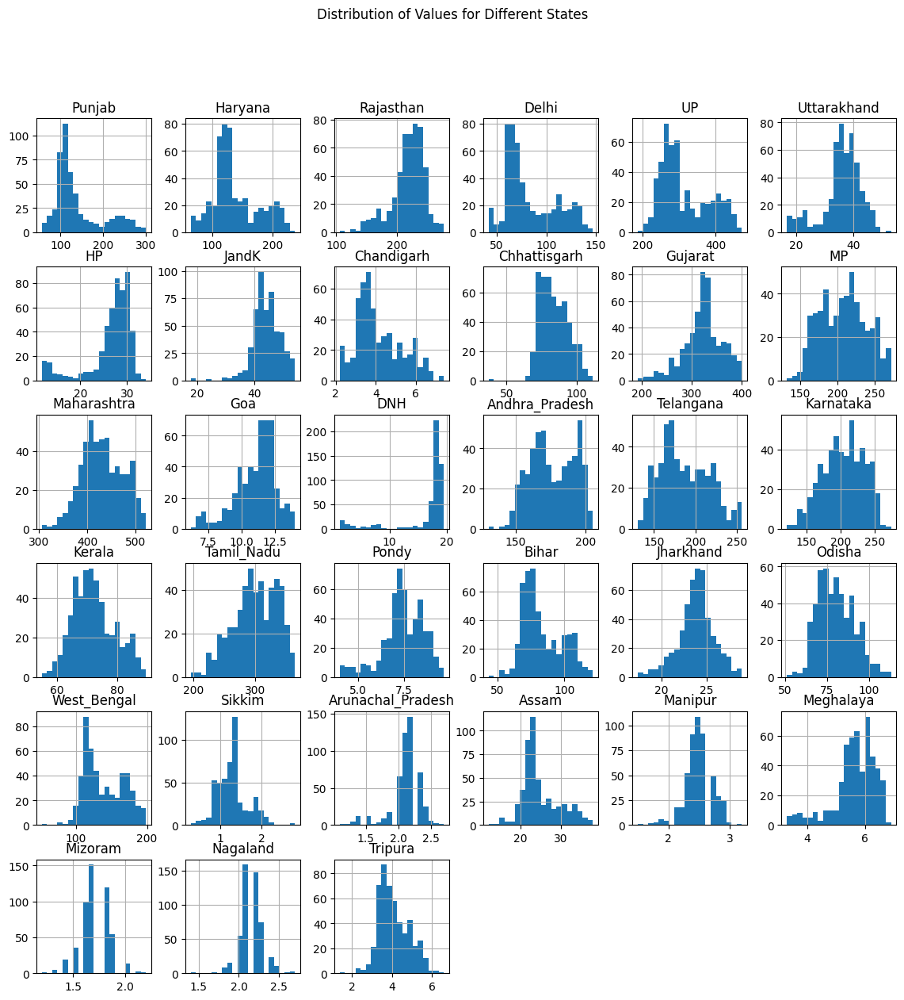

In [8]:
df.hist(figsize=(14, 14), bins=20)
plt.suptitle('Distribution of Values for Different States')
plt.show()

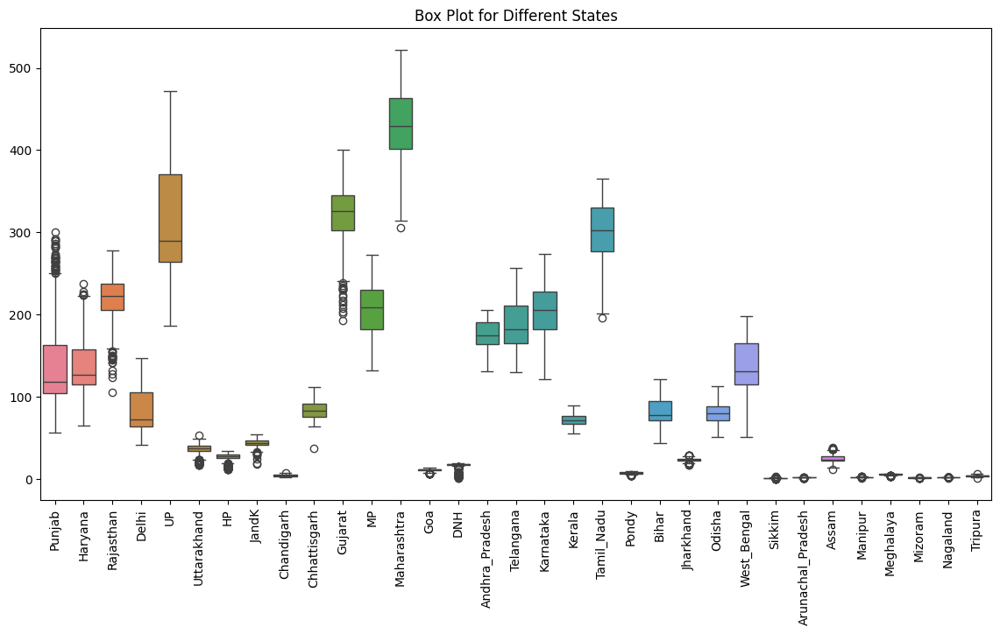

In [9]:
# To identify outliers in the data
plt.figure(figsize=(14, 7))
sns.boxplot(data=df)
plt.title('Box Plot for Different States')
plt.xticks(rotation=90)
plt.show()

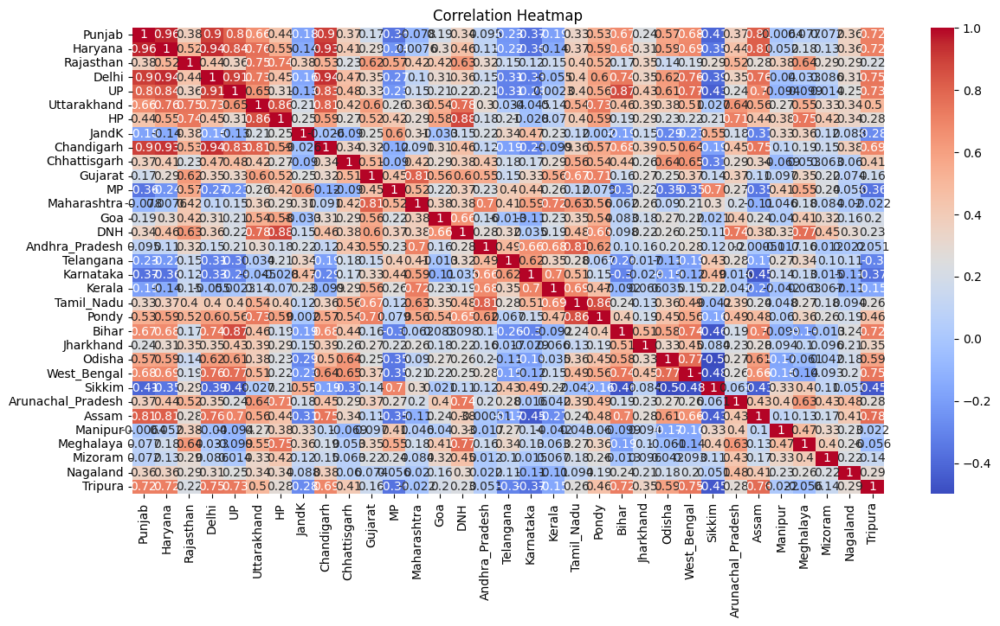

In [10]:
plt.figure(figsize=(14, 7))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

In [11]:
subset = df.columns[:]
sns.pairplot(df[subset])
plt.show()

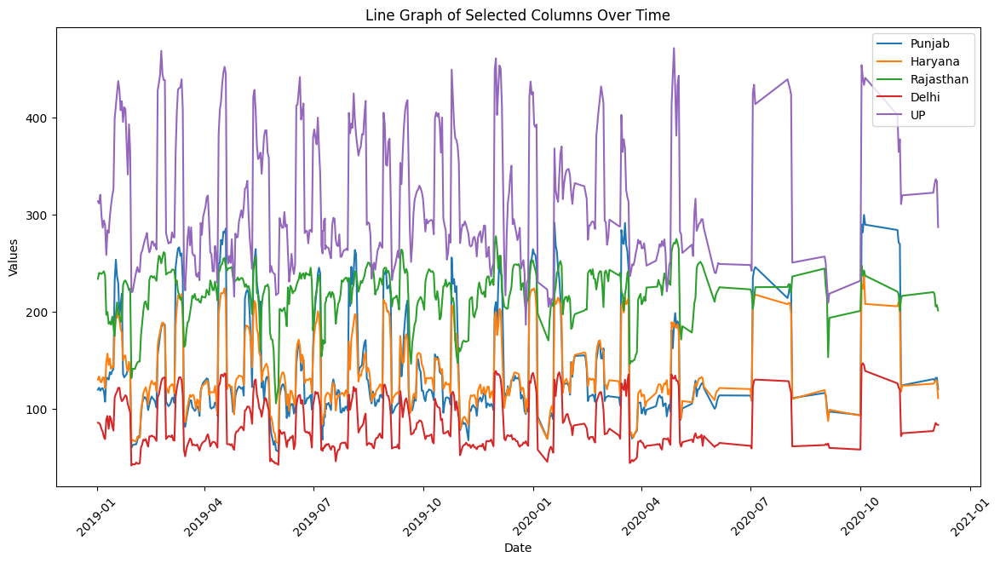

In [12]:
columns_to_plot = df.columns[:5]

plt.figure(figsize=(14, 7))
for column in columns_to_plot:
    plt.plot(df.index, df[column], label=column)

plt.xlabel('Date')
plt.ylabel('Values')
plt.title('Line Graph of Selected Columns Over Time')
plt.xticks(rotation=45)
plt.legend()
plt.show()

Making the model

In [13]:
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error


In [16]:

import warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)
results = {}
for column in df.columns:
    # Split the data into training and testing sets
    train_size = int(len(df) * 0.8)
    train, test = df[column][:train_size], df[column][train_size:]

    # Fit the ARIMA model
    model = ARIMA(train, order=(5, 1, 0))  # (p, d, q) parameters can be tuned
    model_fit = model.fit()

    # Make predictions
    predictions = model_fit.forecast(steps=len(test))
    test.index = predictions.index  # Align the index of the test set with the predictions

    # Evaluate the model
    mse = mean_squared_error(test, predictions)
    results[column] = {
        'model': model_fit,
        'predictions': predictions,
        'mse': mse
    }

    # Print the Mean Squared Error for each column
    print(f"{column} - Mean Squared Error: {mse}")

Punjab - Mean Squared Error: 4639.283003157075
Haryana - Mean Squared Error: 2702.9601647455543
Rajasthan - Mean Squared Error: 1147.2981789486205
Delhi - Mean Squared Error: 1704.0402199241719
UP - Mean Squared Error: 14895.601911334013
Uttarakhand - Mean Squared Error: 110.89743614935564
HP - Mean Squared Error: 25.865650687464967
JandK - Mean Squared Error: 43.88667541859034
Chandigarh - Mean Squared Error: 2.7733164092288396
Chhattisgarh - Mean Squared Error: 272.8284517765306
Gujarat - Mean Squared Error: 3586.8772189526003
MP - Mean Squared Error: 1009.0051608451258
Maharashtra - Mean Squared Error: 5248.896604882837
Goa - Mean Squared Error: 2.4528964689370536
DNH - Mean Squared Error: 27.019683017291868
Andhra_Pradesh - Mean Squared Error: 874.0023396163547
Telangana - Mean Squared Error: 1082.68081872153
Karnataka - Mean Squared Error: 1311.8956150885085
Kerala - Mean Squared Error: 125.24253565263082
Tamil_Nadu - Mean Squared Error: 1935.1093827596028
Pondy - Mean Squared Err

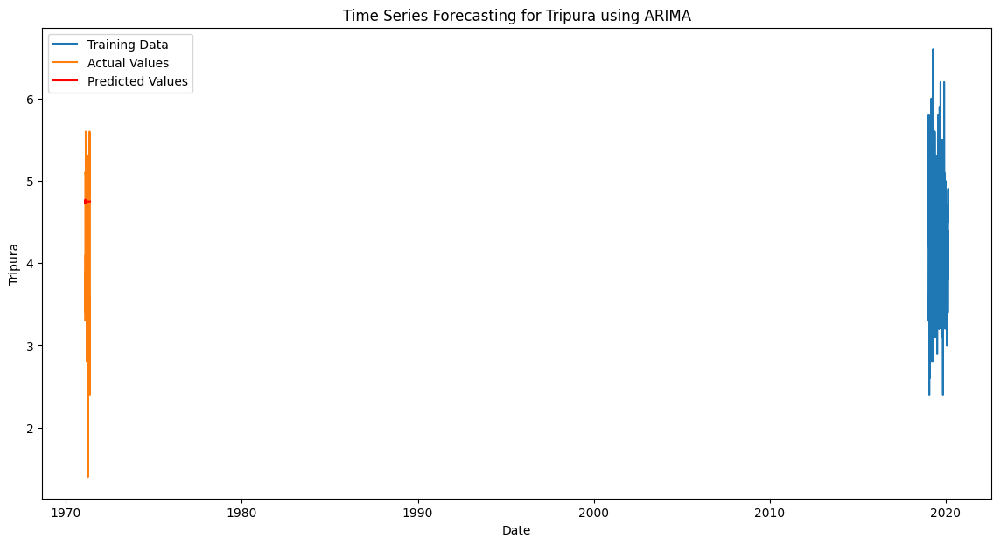

In [15]:
plt.figure(figsize=(14, 7))
plt.plot(train, label='Training Data')
plt.plot(test, label='Actual Values')
plt.plot(predictions, label='Predicted Values', color='red')
plt.xlabel('Date')
plt.ylabel(column)
plt.title(f'Time Series Forecasting for {column} using ARIMA')
plt.legend()
plt.show()

Model 2 

In [18]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

In [24]:
target_column = 'Punjab'


X = np.arange(len(df)).reshape(-1, 1)  
y = df[target_column].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


poly = PolynomialFeatures(degree=3)  
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

model = LinearRegression()
model.fit(X_train_poly, y_train)


LinearRegression()

In [25]:
y_pred = model.predict(X_test_poly)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")


#Similarly, we can just change the target column name to any other state whose data we want to predict.

Mean Squared Error: 3427.0787231273584
R^2 Score: 0.01736973607415837


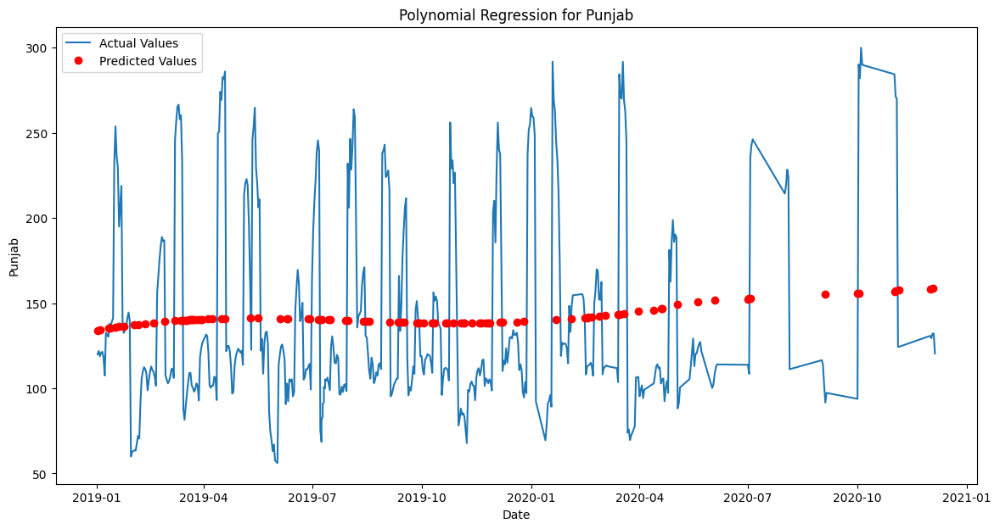

In [26]:
plt.figure(figsize=(14, 7))
plt.plot(df.index, df[target_column], label='Actual Values')
plt.plot(df.index[X_test.flatten()], y_pred, 'ro', label='Predicted Values')
plt.xlabel('Date')
plt.ylabel(target_column)
plt.title(f'Polynomial Regression for {target_column}')
plt.legend()
plt.show()

Model 3

In [21]:
from sklearn.ensemble import RandomForestRegressor

In [30]:
target_column = 'Punjab'

X = df.drop(columns=[target_column])
y = df[target_column]


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [31]:
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

In [32]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")

Mean Squared Error: 180.4364788019802
R^2 Score: 0.9482642918032408


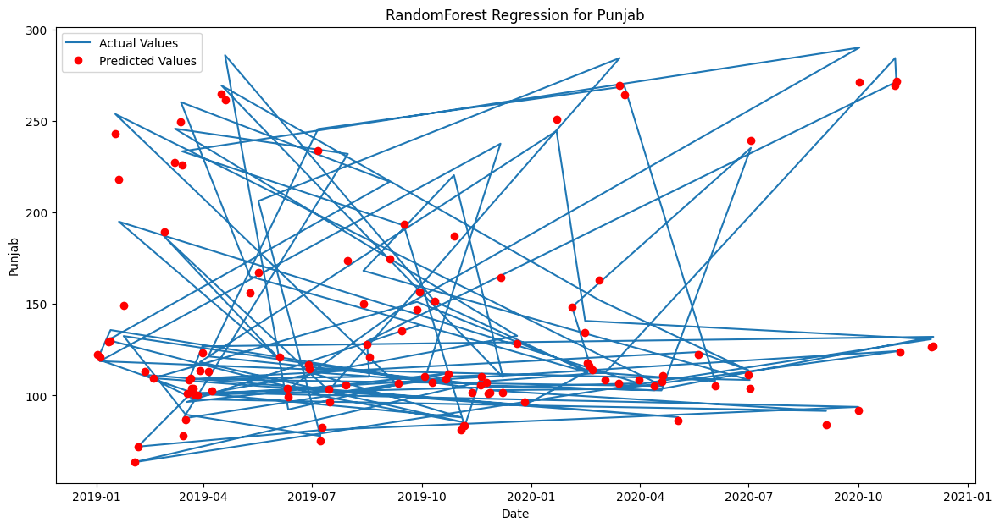

In [ ]:
plt.figure(figsize=(14, 7))
plt.plot(y_test.index, y_test, label='Actual Values')
plt.plot(y_test.index, y_pred, 'ro', label='Predicted Values')
plt.xlabel('Date')
plt.ylabel(target_column)
plt.title(f'RandomForest Regression for {target_column}')
plt.legend()
plt.show()



#Similarly, we can just change the target column name to any other state whose data we want to predict.